In [1]:
# Python 3.9.5
# qpsolvers 4.0.0
# SCS 3.2.3
# Mosek 10.1

In [2]:
%matplotlib inline

In [3]:
from grale.all_nb import *
import glob
import os
from IPython.display import display, HTML
import subprocess
import scipy

renderers.setDefaultMassRenderer(None)
renderers.setDefaultLensPlaneRenderer(None)

Set 'threads' as default renderer for lensplane and mass density
Set default angular unit in plotting to arcsec
Set feedback style to 'notebook'


In [4]:
cosm = cosmology.Cosmology(0.7, 0.27, 0, 0.73)
D = cosm.getAngularDiameterDistance
cosmology.setDefaultCosmology(cosm)

zd = 0.68
zs1 = 1.734

critDens = lenses.getCriticalDensity(D(zd), D(zs1), D(zd,zs1))

In [5]:
subLenses = glob.glob("best_*.lensdata")
lens = lenses.CompositeLens(D(zd), [ { "lens": lenses.GravitationalLens.load(fn), "factor": 1/len(subLenses), 
                                       "angle": 0, "x": 0, "y": 0} for fn in subLenses])
print("Using average of", len(subLenses), "lenses")

Using average of 40 lenses


In [6]:
# File should be created by other notebook
psiLens = lenses.GravitationalLens.load("avgmodel_psidetailed.lensdata")

In [7]:
liPsiLens = plotutil.LensInfo(psiLens, size=35*ANGLE_ARCSEC, center=V(5,5)*ANGLE_ARCSEC, zd=zd, zs=zs1)

In [8]:
imgList = images.readInputImagesFile("SDSSJ1004points.txt", True)
iws = inversion.InversionWorkSpace(zd, 40*ANGLE_ARCSEC)
for i in imgList:
    iws.addImageDataToList(i["imgdata"], i["z"], "pointimages")

In [9]:
def getEquivLens(N, gradPotWeight, densWeight, solver, pixelEnlargements=2, diag=False):
    
    if pixelEnlargements == 2 and not diag:
        fn = f"eq_model-N_{N}-gpw_{gradPotWeight}-dw_{densWeight}-s_{solver}.lensdata"
    else:
        if not diag:
            fn = f"eq_model-N_{N}-gpw_{gradPotWeight}-dw_{densWeight}-s_{solver}-pe_{pixelEnlargements}.lensdata"
        else:
            fn = f"eq_model-N_{N}-gpw_{gradPotWeight}-dw_{densWeight}-s_{solver}-pe_{pixelEnlargements}-diag.lensdata"

    if os.path.exists(fn):
        return lenses.GravitationalLens.load(fn)
    
    raise Exception("File should have been created in other notebook")

In [10]:
K_5_BB = np.array([[  0, 0,  1, 0, 0 ],
                   [  0, 1,  2, 1, 0 ],
                   [  1, 2,-16, 2, 1 ],
                   [  0, 1,  2, 1, 0 ],
                   [  0, 0,  1, 0, 0 ]],dtype=np.double)

In [11]:
def plotPhiGrid(newPsiLens):
    p = newPsiLens.getLensParameters()
    tr = np.array(p["topright"])/ANGLE_ARCSEC
    bl = np.array(p["bottomleft"])/ANGLE_ARCSEC
    ny, nx = p["values"].shape
    segsx = []
    segsy = []
    for y in range(0,ny):
        yc = y/(ny-1) * (tr[1]-bl[1]) + bl[1]
        segsx += [bl[0], tr[0], None ]
        segsy += [yc, yc, None ]
        
    for x in range(0,nx):
        xc = x/(nx-1) * (tr[0]-bl[0]) + bl[0]
        segsy += [bl[1], tr[1], None ]
        segsx += [xc, xc, None ]
    
    plt.plot(segsx, segsy, "-", color="#00000080", lw=0.2)

def plotDens(li):
    zMax = 3.5
    plotutil.plotDensityContours(li, densityUnit=critDens, levels=np.arange(0.2, zMax, 0.2), linewidths=0.5, colors="black", linestyles="-")
    plotutil.plotDensityContours(li, densityUnit=critDens, levels=[1], linewidths=[2], colors="black")
    plt.gca().set_xlabel(r"$\theta_x$ (arcsec)")
    plt.gca().set_ylabel(r"$\theta_y$ (arcsec)")
        
def plotImgs():
    thetas = np.array([ pt["position"] for i in imgList for img in i["imgdata"].getAllImagePoints() for pt in img ])/ANGLE_ARCSEC
    #print(thetas)
    #plt.plot(thetas[:,0], thetas[:,1], 'x', color="black", ms=5)
    plt.plot(thetas[:,0], thetas[:,1], 'x', color="blue", ms=5)

regAll = { "size": 35*ANGLE_ARCSEC, "center": V(5,5)*ANGLE_ARCSEC }

def createPlots(newPsiLens, reg, arrowCenter=True, fn=None):
    #liNewPsiLens = plotutil.LensInfo(newPsiLens, size=35*ANGLE_ARCSEC, center=V(5,5)*ANGLE_ARCSEC, zd=zd, zs=zs1)
    #liNewPsiLens = plotutil.LensInfo(newPsiLens, size=5*ANGLE_ARCSEC, center=V(19,14)*ANGLE_ARCSEC, zd=zd, zs=zs1)
    
    plt.figure(figsize=(15,5))
       
    plt.subplot(1,3,1)
    
    liNewPsiLens = plotutil.LensInfo(newPsiLens, **regAll, zd=zd, zs=zs1)
    liNewPsiLens.getDensityPoints(feedbackObject="None")
    plotDens(liNewPsiLens)
    plotImgs()
    dx, dy = -2, 2
    x, y = reg["center"]/ANGLE_ARCSEC

    plt.arrow(x-dx,y-dy,dx,dy, width=0.2, edgecolor="red", length_includes_head=True)
    
    plt.subplot(1,3,2)
    liNewPsiLens = plotutil.LensInfo(newPsiLens, **reg, zd=zd, zs=zs1)
    liNewPsiLens.getDensityPoints(feedbackObject="None")

    liTmp = plotutil.LensInfo(newPsiLens, **reg, zd=zd, zs=zs1)
    vmin = np.min(liTmp.getDensityPoints())/critDens
    vmax = np.max(liTmp.getDensityPoints())/critDens

    plotutil.plotDensity(liNewPsiLens, densityUnit=critDens, vmin=vmin, vmax=vmax, cmap="gray")
    plotImgs()
    plt.gca().set_xlabel(r"$\theta_x$ (arcsec)")
    plt.gca().set_ylabel(r"$\theta_y$ (arcsec)")

    plotPhiGrid(newPsiLens)
    xlim = plt.gca().get_xlim()
    ylim = plt.gca().get_ylim()
    
    
    plt.subplot(1,3,3)
        
    params = newPsiLens.getLensParameters()
    psi, tr, bl = params["values"], np.array(params["topright"]), np.array(params["bottomleft"])
    NY, NX = psi.shape
    
    K = K_5_BB
    #K = K_11_opt_zeros
    dens = scipy.ndimage.convolve(psi, K)
    sheet = lenses.MassSheetLens(newPsiLens.getLensDistance(), { "density": 1.0 })
    thetas = util.createThetaGrid(bl, tr, NX, NY)
    sheetPsi = sheet.getProjectedPotential(1,1,thetas)
    sheetDens = scipy.ndimage.convolve(sheetPsi, K)[5:-5,5:-5]
    # This should be rescaled so that it's one
    scaleFactor = np.mean(sheetDens)

    dens /= scaleFactor
    dens /= critDens

    plt.imshow(dens, cmap="gray", extent=[bl[0]/ANGLE_ARCSEC, tr[0]/ANGLE_ARCSEC, tr[1]/ANGLE_ARCSEC, bl[1]/ANGLE_ARCSEC], vmin=vmin, vmax=vmax)
    plt.gca().set_xlim(*xlim)
    plt.gca().set_ylim(*ylim)
    #plotPhiGrid(newPsiLens)
    plt.gca().set_xlabel(r"$\theta_x$ (arcsec)")
    plt.gca().set_ylabel(r"$\theta_y$ (arcsec)")
    
    plt.show()
    
    plotutil.plotDensityInteractive(liNewPsiLens, densityUnit=critDens, numX=100, numY=100)
    return liNewPsiLens

In [12]:
# The grid that's shown shows the points where the lens potential is defined. All properties
# are calculated using the bicubic interpolation of the GSL library, which leads to a good
# interpolation of the potential itself, the first order derivatives (deflection angles)
# and second order derivatives (e.g. to kappa)
def createZoomedPlots(newPsiLens, fnPrefix = None):
    for pt in np.array([ pt["position"] for i in imgList for img in i["imgdata"].getAllImagePoints() for pt in img ]):
        regPt = { "size": 0.75*ANGLE_ARCSEC, "center": pt }
        s = "Centered on {}".format(pt/ANGLE_ARCSEC)
        print(s)
        print("="*len(s))

        fn = fnPrefix + "_{}_{}.pdf".format(pt[0]/ANGLE_ARCSEC, pt[1]/ANGLE_ARCSEC) if fnPrefix else None
        li = createPlots(newPsiLens, regPt, True, fn)
        dens = li.getDensityPoints()/critDens
        s = "Max: {:g} Min: {:g} diff: {:g}".format(np.max(dens), np.min(dens), np.max(dens)-np.min(dens))

        print(s)
        print("-"*len(s))
        
        #break

In [13]:
newPsiLens = getEquivLens(1536, 0.0001, 0.1, "scs", 4)

Centered on [0. 0.]


Text(value='')

FloatProgress(value=0.0)

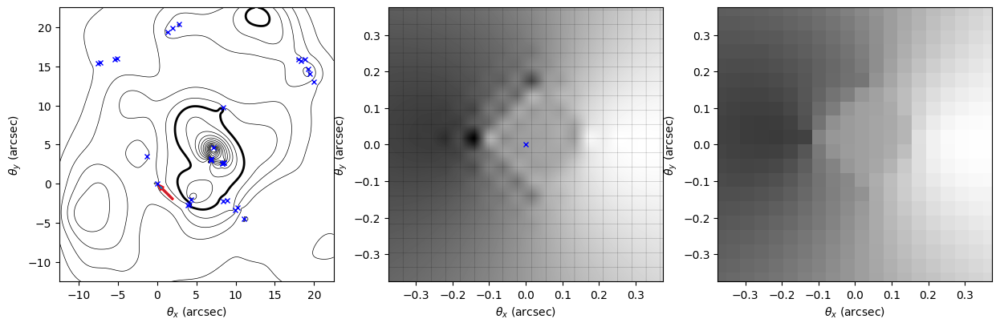

Max: 0.767958 Min: 0.265616 diff: 0.502342
------------------------------------------
Centered on [-1.31700164  3.532     ]


Text(value='')

FloatProgress(value=0.0)

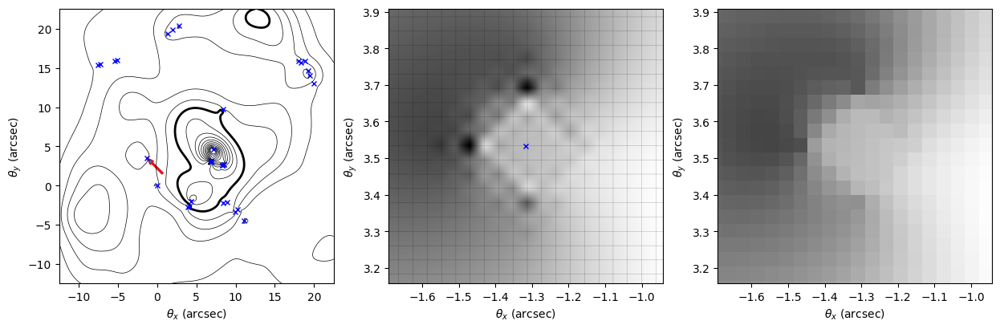

Max: 0.469284 Min: 0.191591 diff: 0.277693
------------------------------------------
Centered on [11.03899996 -4.492     ]


Text(value='')

FloatProgress(value=0.0)

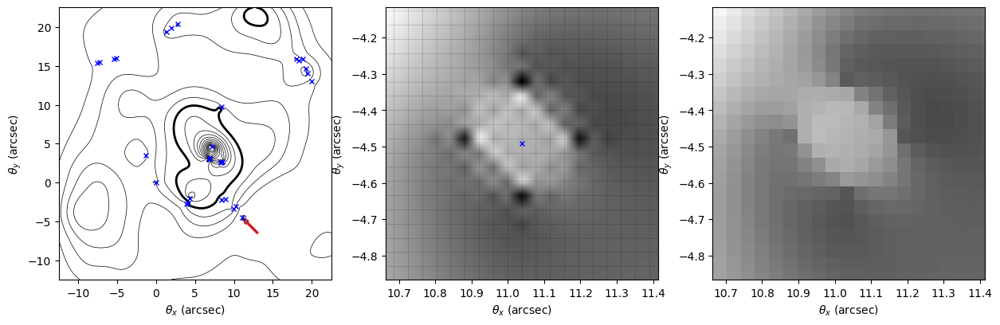

Max: 0.323845 Min: 0.126356 diff: 0.197489
------------------------------------------
Centered on [8.39899977 9.707     ]


Text(value='')

FloatProgress(value=0.0)

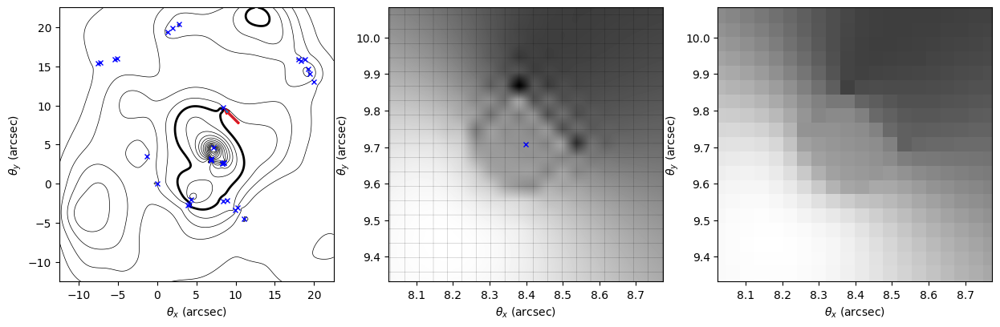

Max: 1.03044 Min: 0.569016 diff: 0.461426
-----------------------------------------
Centered on [7.19700024 4.603     ]


Text(value='')

FloatProgress(value=0.0)

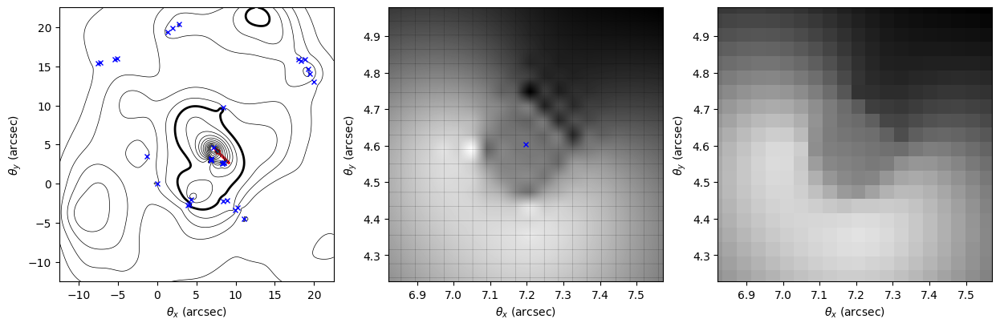

Max: 4.06983 Min: 2.39576 diff: 1.67407
---------------------------------------
Centered on [ 3.93000017 -2.78      ]


Text(value='')

FloatProgress(value=0.0)

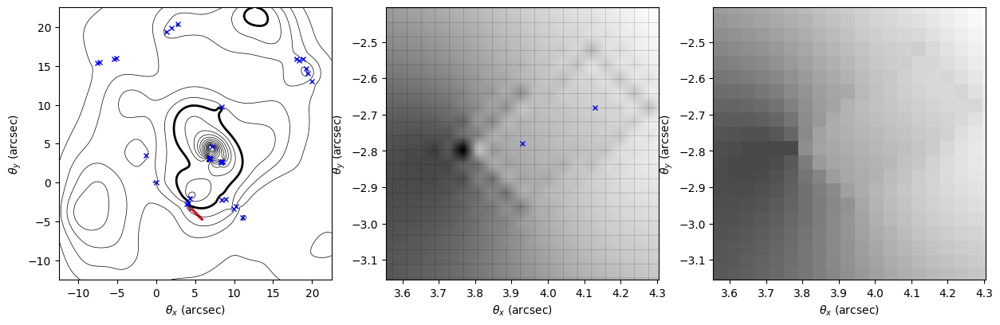

Max: 1.08015 Min: 0.43898 diff: 0.641172
----------------------------------------
Centered on [ 1.32999963 19.37      ]


Text(value='')

FloatProgress(value=0.0)

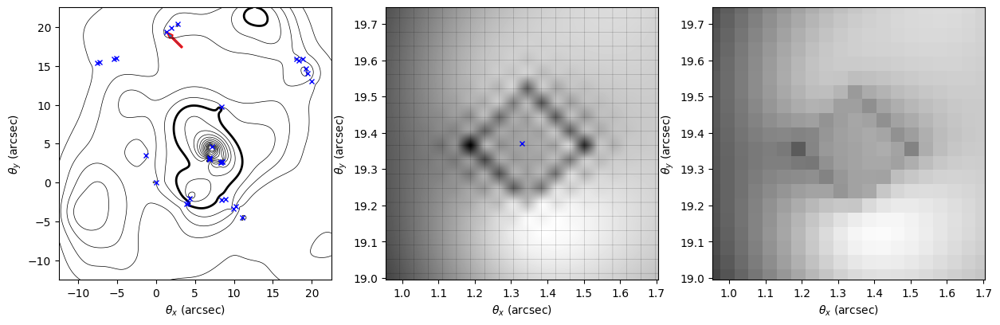

Max: 0.661611 Min: 0.554654 diff: 0.106957
------------------------------------------
Centered on [19.23 14.67]


Text(value='')

FloatProgress(value=0.0)

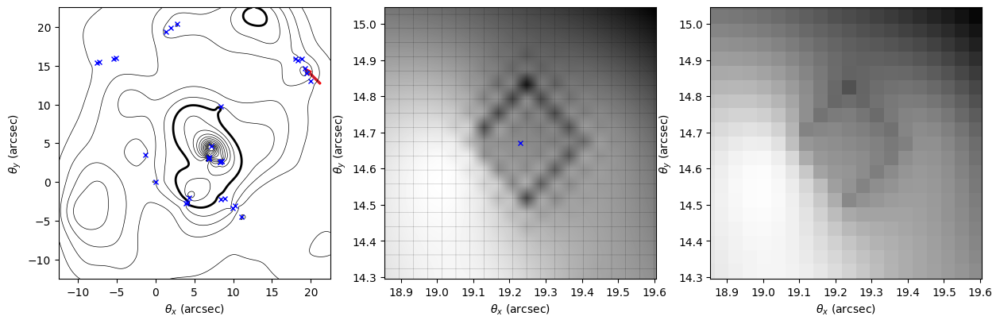

Max: 0.857485 Min: 0.664881 diff: 0.192604
------------------------------------------
Centered on [18.82999989 15.87      ]


Text(value='')

FloatProgress(value=0.0)

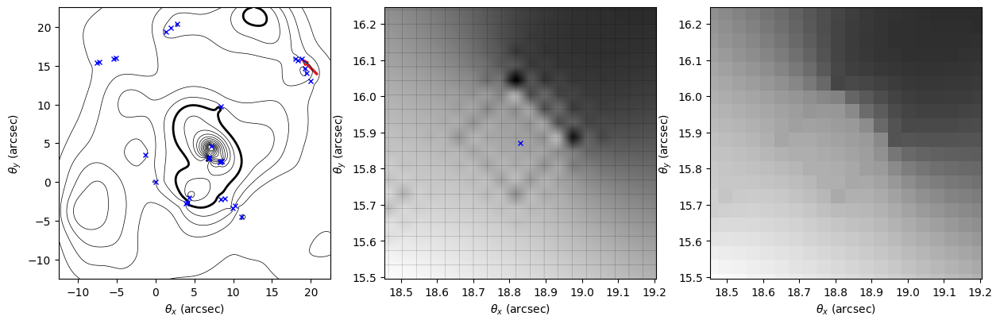

Max: 0.715463 Min: 0.382569 diff: 0.332894
------------------------------------------
Centered on [6.82999995 3.22      ]


Text(value='')

FloatProgress(value=0.0)

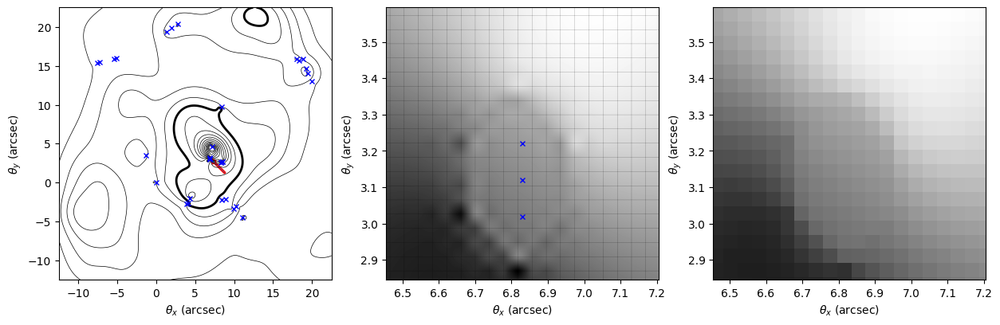

Max: 3.00841 Min: 0.741138 diff: 2.26727
----------------------------------------
Centered on [ 4.12999956 -2.68      ]


Text(value='')

FloatProgress(value=0.0)

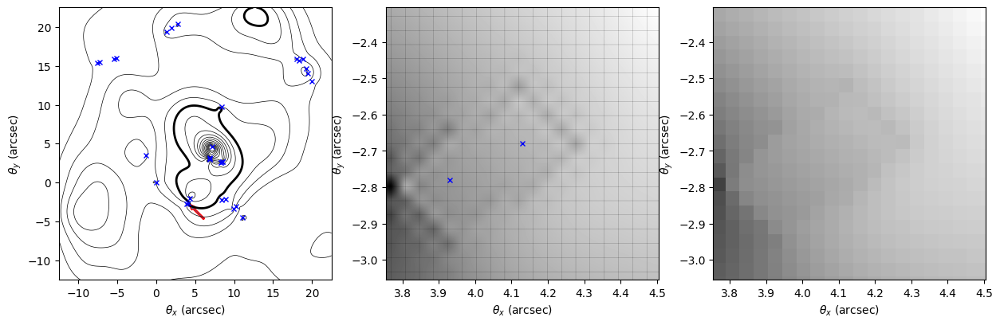

Max: 1.17837 Min: 0.437251 diff: 0.741116
-----------------------------------------
Centered on [ 1.930001 19.87    ]


Text(value='')

FloatProgress(value=0.0)

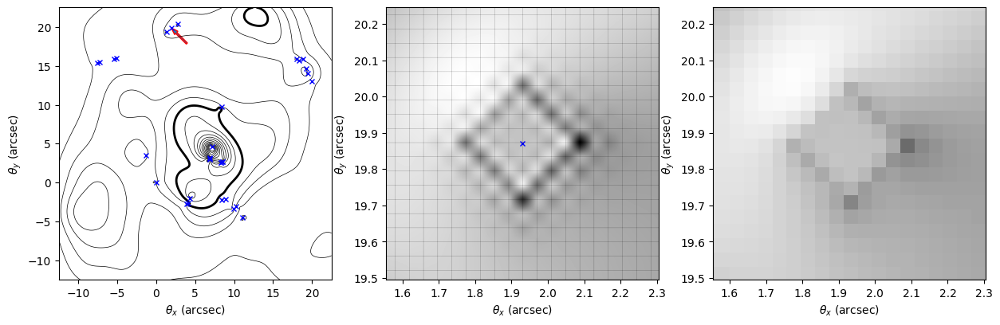

Max: 0.66045 Min: 0.54175 diff: 0.1187
--------------------------------------
Centered on [19.42999992 14.02      ]


Text(value='')

FloatProgress(value=0.0)

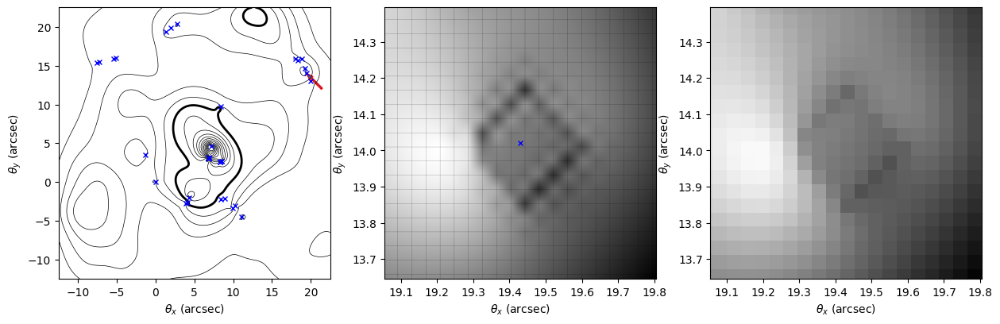

Max: 0.884411 Min: 0.66911 diff: 0.215301
-----------------------------------------
Centered on [18.33 15.72]


Text(value='')

FloatProgress(value=0.0)

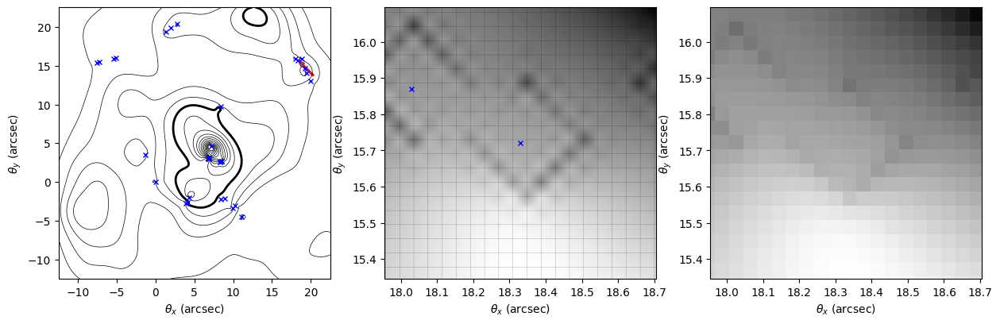

Max: 0.734647 Min: 0.53502 diff: 0.199627
-----------------------------------------
Centered on [6.82999995 3.12      ]


Text(value='')

FloatProgress(value=0.0)

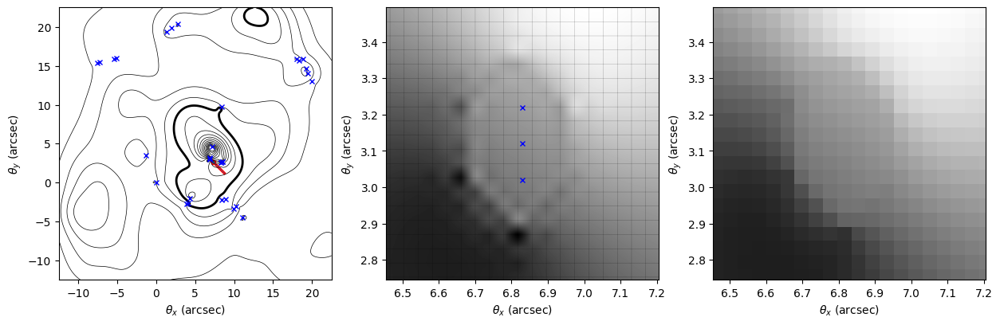

Max: 2.97037 Min: 0.736142 diff: 2.23423
----------------------------------------
Centered on [ 4.3299997 -1.98     ]


Text(value='')

FloatProgress(value=0.0)

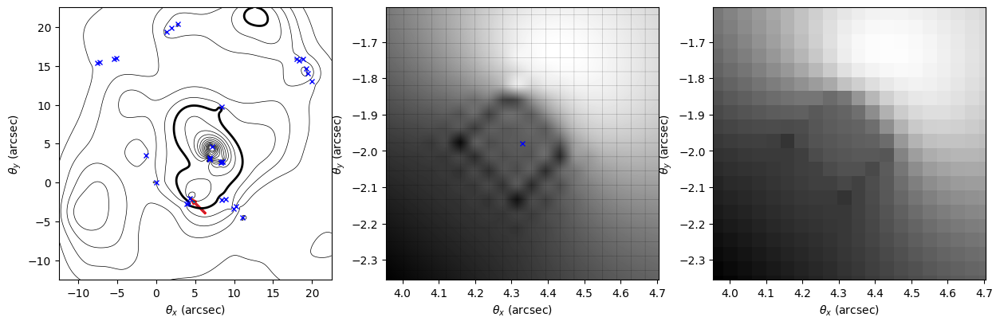

Max: 1.57702 Min: 0.980678 diff: 0.596343
-----------------------------------------
Centered on [ 2.72999942 20.37      ]


Text(value='')

FloatProgress(value=0.0)

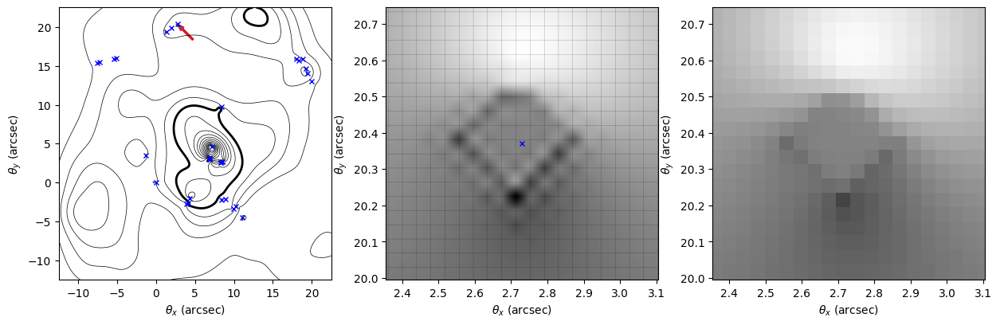

Max: 0.741726 Min: 0.509458 diff: 0.232269
------------------------------------------
Centered on [19.94999991 13.04      ]


Text(value='')

FloatProgress(value=0.0)

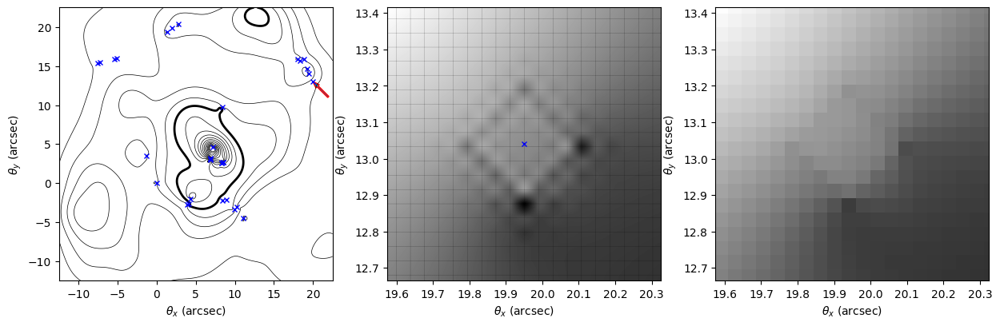

Max: 0.673096 Min: 0.344973 diff: 0.328123
------------------------------------------
Centered on [18.0300001 15.87     ]


Text(value='')

FloatProgress(value=0.0)

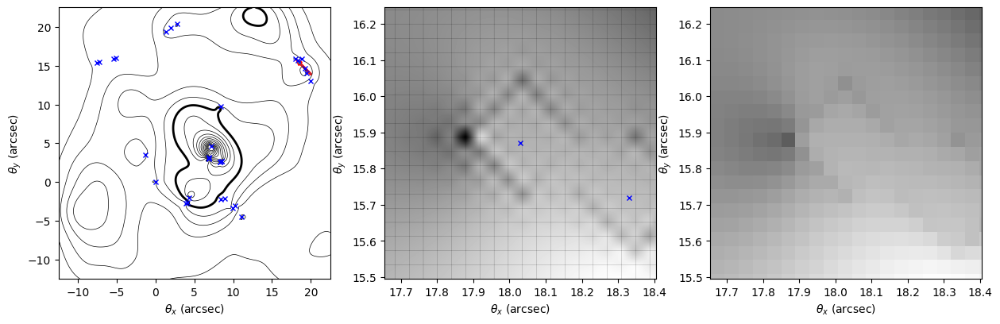

Max: 0.727544 Min: 0.485437 diff: 0.242107
------------------------------------------
Centered on [6.82999995 3.02      ]


Text(value='')

FloatProgress(value=0.0)

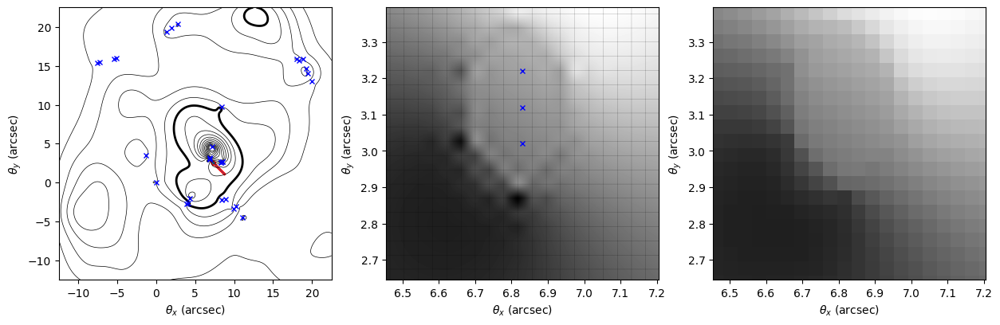

Max: 2.90019 Min: 0.735607 diff: 2.16458
----------------------------------------
Centered on [ 8.88000021 -2.16      ]


Text(value='')

FloatProgress(value=0.0)

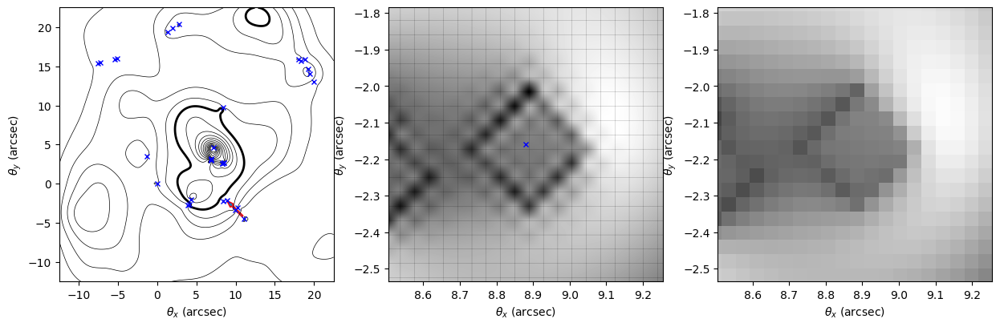

Max: 0.97973 Min: 0.846851 diff: 0.132879
-----------------------------------------
Centered on [-5.45000034 15.84      ]


Text(value='')

FloatProgress(value=0.0)

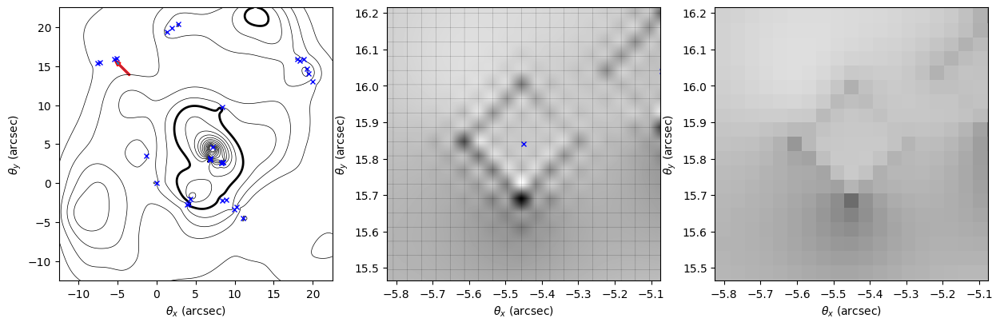

Max: 0.302468 Min: 0.230693 diff: 0.0717742
-------------------------------------------
Centered on [8.32999977 2.57      ]


Text(value='')

FloatProgress(value=0.0)

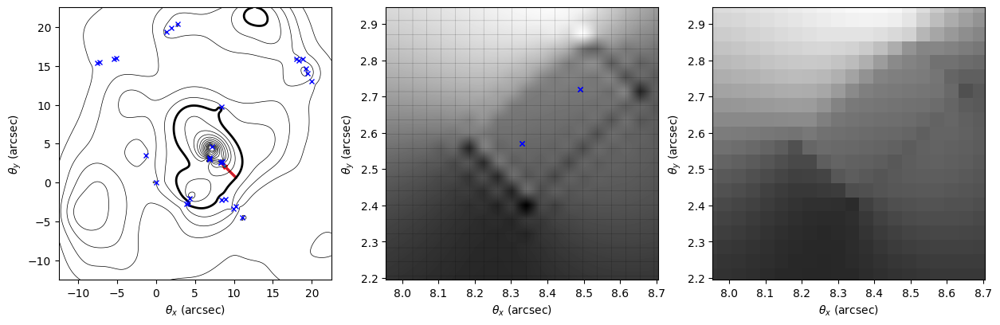

Max: 2.33774 Min: 1.25378 diff: 1.08396
---------------------------------------
Centered on [ 8.44999993 -2.26      ]


Text(value='')

FloatProgress(value=0.0)

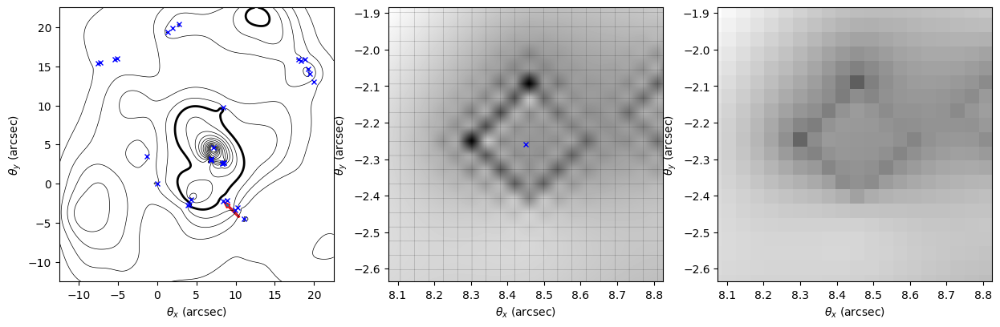

Max: 0.991437 Min: 0.772367 diff: 0.21907
-----------------------------------------
Centered on [-5.06999955 16.04      ]


Text(value='')

FloatProgress(value=0.0)

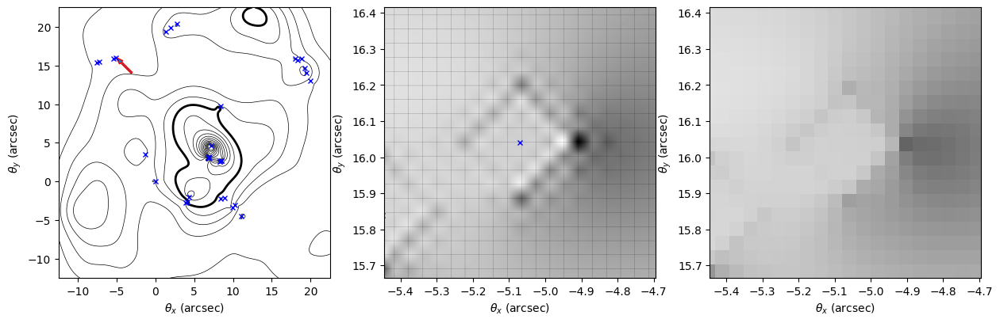

Max: 0.304015 Min: 0.201312 diff: 0.102703
------------------------------------------
Centered on [8.32999977 2.57      ]


Text(value='')

FloatProgress(value=0.0)

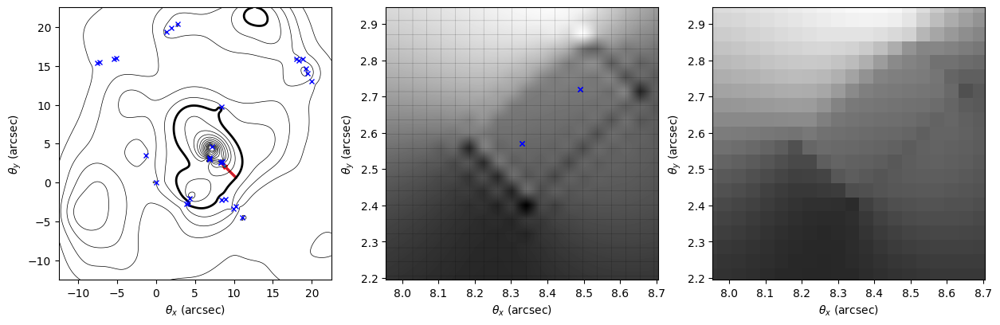

Max: 2.33774 Min: 1.25378 diff: 1.08396
---------------------------------------
Centered on [10.24999996 -3.06      ]


Text(value='')

FloatProgress(value=0.0)

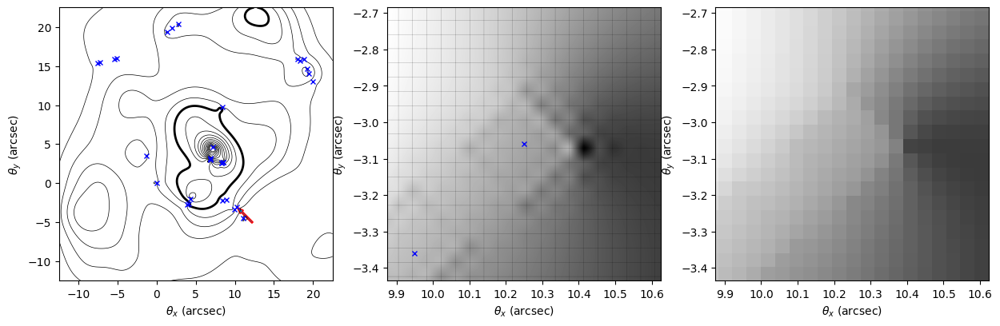

Max: 0.780997 Min: 0.291404 diff: 0.489593
------------------------------------------
Centered on [-7.5500002 15.39     ]


Text(value='')

FloatProgress(value=0.0)

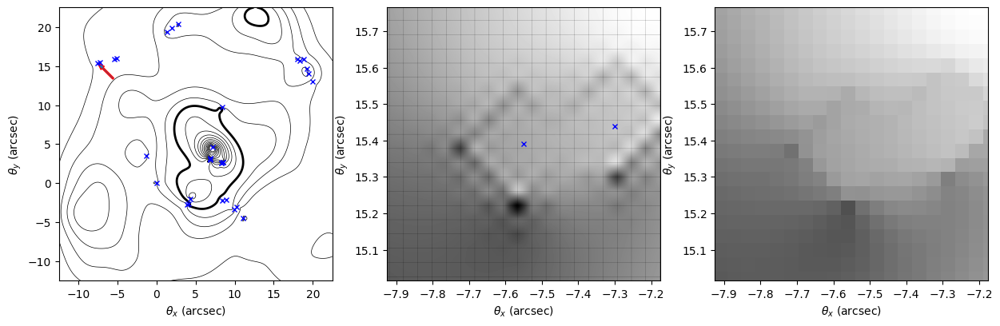

Max: 0.269174 Min: 0.174246 diff: 0.0949287
-------------------------------------------
Centered on [8.48999991 2.72      ]


Text(value='')

FloatProgress(value=0.0)

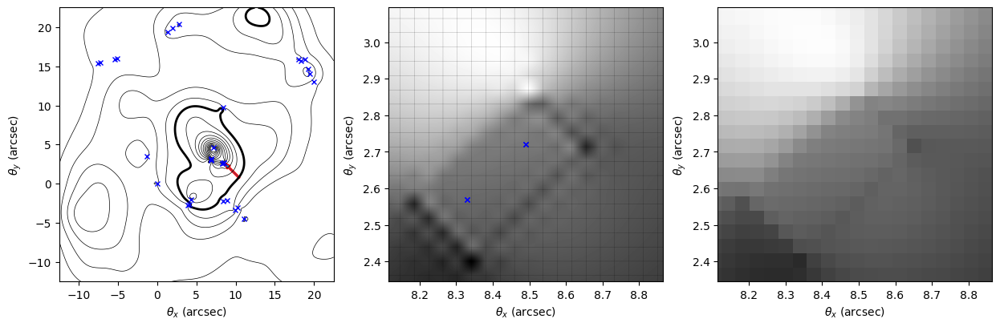

Max: 2.3374 Min: 1.25459 diff: 1.08281
--------------------------------------
Centered on [ 9.95000021 -3.36      ]


Text(value='')

FloatProgress(value=0.0)

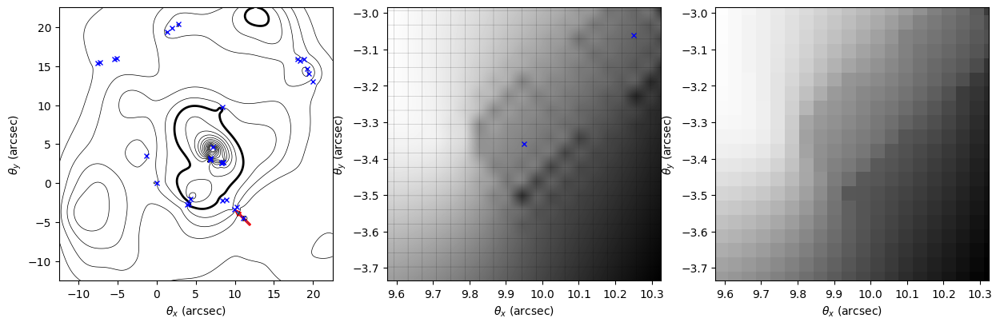

Max: 0.828678 Min: 0.467632 diff: 0.361046
------------------------------------------
Centered on [-7.30000021 15.44      ]


Text(value='')

FloatProgress(value=0.0)

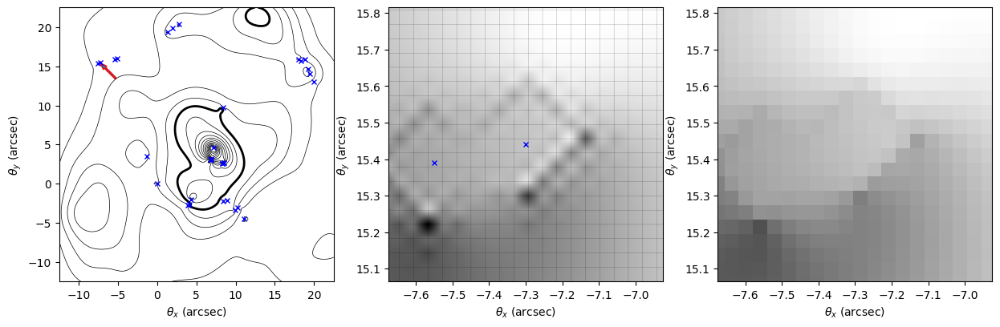

Max: 0.269292 Min: 0.1744 diff: 0.0948923
-----------------------------------------
Centered on [8.48999991 2.72      ]


Text(value='')

FloatProgress(value=0.0)

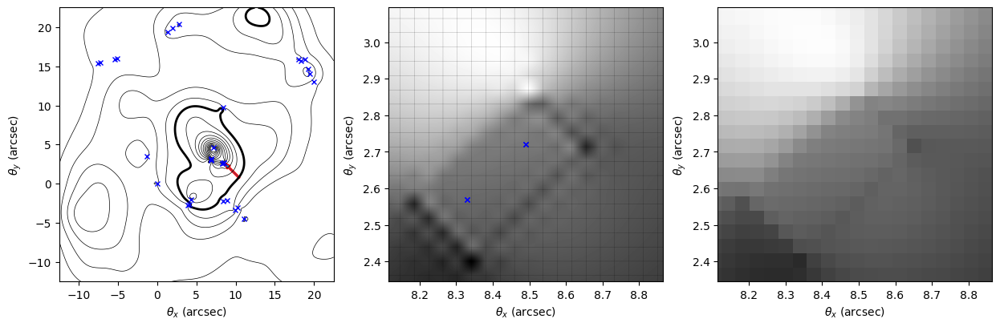

Max: 2.3374 Min: 1.25459 diff: 1.08281
--------------------------------------


In [14]:
createZoomedPlots(newPsiLens, "zoom_scs_1536_pe_4")